In [0]:
import tensorflow as tf
import tensornets as nets  #importing all the libraries
import cv2
import numpy as np
import time
import shutil
from gluoncv import model_zoo, data, utils

In [ ]:
!pip install --upgrade mxnet-cu100mkl gluoncv

In [0]:
!pip install numpy==1.16.2
import numpy as np

     |████████████████████████████████| 17.3MB 9.2MB/s 
ERROR: datascience 0.10.6 has requirement folium==0.2.1, but you'll have folium 0.8.3 which is incompatible.
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: numpy 1.16.4
    Uninstalling numpy-1.16.4:
      Successfully uninstalled numpy-1.16.4


In [0]:
!pip install tensornets

     |████████████████████████████████| 593kB 9.5MB/s 
  Stored in directory: /root/.cache/pip/wheels/0c/ae/7a/6d31e83c89c2b02c13e8f08ee8e20abe71670061e057a6058f
Successfully built tensornets


importing necessary libraries

In [0]:
classes={'0':'person','1':'bicycle','2':'car','3':'bike','5':'bus','7':'truck'}
list_of_classes=[0,1,2,3,5,7]  #classes i want to detect

In [0]:
classes['0']

'person'

In [0]:
import tensorflow as tf
import tensornets as nets

inputs = tf.placeholder(tf.float32, [None, 416, 416, 3])
model = nets.YOLOv3COCO(inputs, nets.Darknet19) # downloading yolococov3 for detecting model

img = nets.utils.load_img('traffic_image1.jpg')

with tf.Session() as sess:
    sess.run(model.pretrained())
    preds = sess.run(model.preds, {inputs: model.preprocess(img)})
    boxes = model.get_boxes(preds, img.shape[1:3])

W0710 17:27:16.401358 140092747843456 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/tensornets/utils.py:238: The name tf.variable_scope is deprecated. Please use tf.compat.v1.variable_scope instead.

W0710 17:27:16.672664 140092747843456 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/tensornets/utils.py:277: The name tf.get_variable_scope is deprecated. Please use tf.compat.v1.get_variable_scope instead.

W0710 17:27:19.543629 140092747843456 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/tensornets/utils.py:246: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0710 17:27:19.544874 140092747843456 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/tensornets/utils.py:125: The name tf.get_collection is deprecated. Please use tf.compat.v1.get_collection instead.

W0710 17:27:20.907469 140092747843456 deprecation_wrapper.py:119] From /usr/local/

In [0]:
boxes #boxes with prediction

[array([[1.33000000e+02, 7.00000000e+01, 1.43000000e+02, 8.60000000e+01,
         1.50224105e-01],
        [1.22000000e+02, 7.40000000e+01, 1.30000000e+02, 9.30000000e+01,
         1.28971487e-01],
        [1.63000000e+02, 8.20000000e+01, 1.78000000e+02, 1.16000000e+02,
         3.77563477e-01],
        [6.10000000e+01, 9.10000000e+01, 7.70000000e+01, 1.28000000e+02,
         4.45959717e-01],
        [7.10000000e+01, 9.20000000e+01, 8.40000000e+01, 1.26000000e+02,
         2.01822340e-01],
        [9.40000000e+01, 1.13000000e+02, 1.17000000e+02, 1.38000000e+02,
         1.71198949e-01],
        [1.84000000e+02, 1.23000000e+02, 2.09000000e+02, 1.62000000e+02,
         3.80127460e-01],
        [3.00000000e+00, 1.38000000e+02, 2.80000000e+01, 1.75000000e+02,
         3.16118598e-01],
        [2.00000000e+00, 1.41000000e+02, 1.40000000e+01, 1.89000000e+02,
         1.59698725e-01],
        [1.00000000e+00, 1.58000000e+02, 1.20000000e+01, 2.06000000e+02,
         1.42328635e-01],
        [3

1

In [0]:
for l in list_of_classes:
  print(l)

0
1
2
3
5
7


person: [133.         70.        143.         86.          0.1502241]


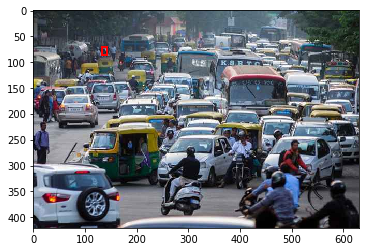

person: [1.2200000e+02 7.4000000e+01 1.3000000e+02 9.3000000e+01 1.2897149e-01]


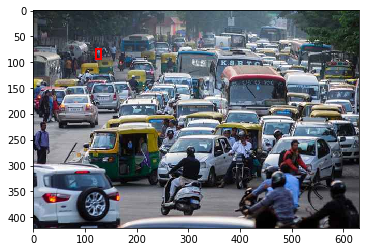

person: [163.          82.         178.         116.           0.37756348]


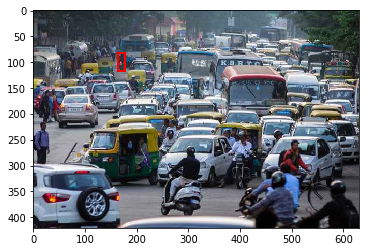

person: [ 61.          91.          77.         128.           0.44595972]


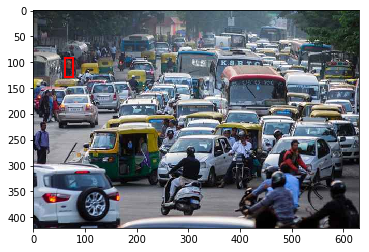

person: [ 71.          92.          84.         126.           0.20182234]


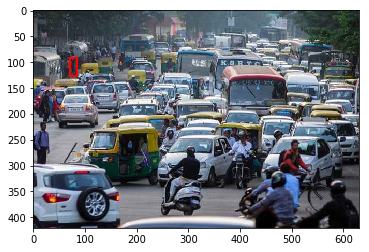

person: [ 94.         113.         117.         138.           0.17119895]


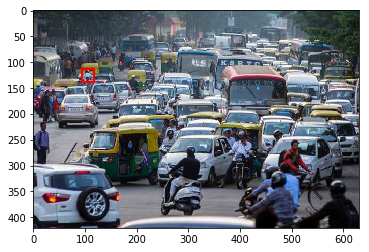

person: [184.         123.         209.         162.           0.38012746]


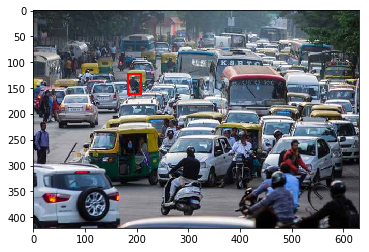

person: [  3.        138.         28.        175.          0.3161186]


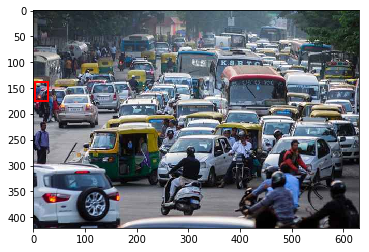

person: [2.0000000e+00 1.4100000e+02 1.4000000e+01 1.8900000e+02 1.5969872e-01]


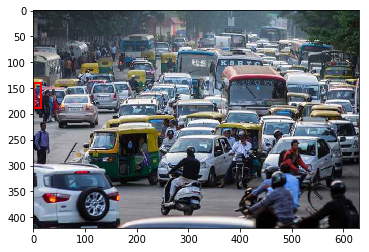

person: [1.0000000e+00 1.5800000e+02 1.2000000e+01 2.0600000e+02 1.4232863e-01]


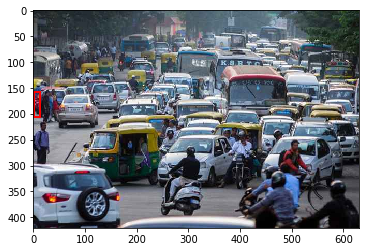

person: [3.6400000e+02 2.2700000e+02 3.9100000e+02 2.5200000e+02 1.3872652e-01]


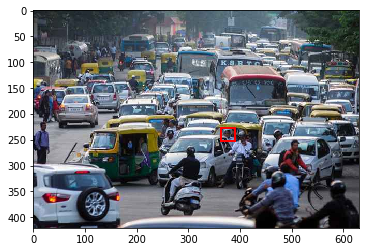

person: [4.6200000e+02 2.2600000e+02 4.8800000e+02 2.5500000e+02 2.0775084e-01]


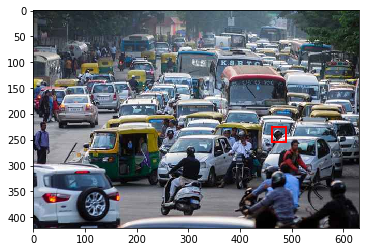

person: [1.7400000e+02 2.4600000e+02 1.9700000e+02 2.7900000e+02 2.1200444e-01]


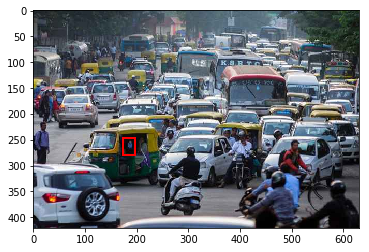

person: [ 14.         154.          52.         219.           0.38183984]


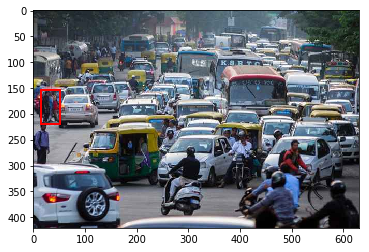

person: [  3.         216.          32.         294.           0.96513015]


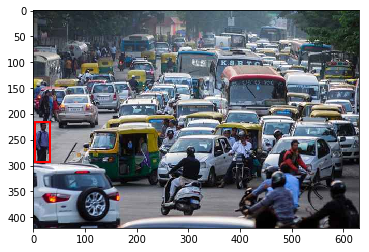

person: [4.42000000e+02 2.19000000e+02 4.99000000e+02 2.77000000e+02
 1.17517814e-01]


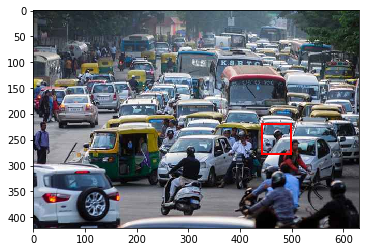

person: [1.7200000e+02 2.4500000e+02 2.0700000e+02 3.2100000e+02 1.4231956e-01]


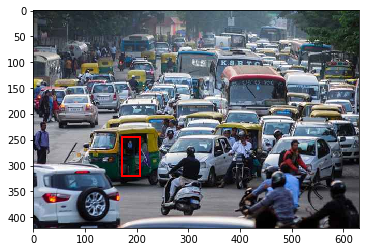

person: [380.        237.        429.        325.          0.7960996]


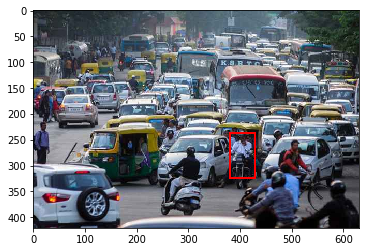

person: [2.740000e+02 2.680000e+02 3.210000e+02 3.310000e+02 2.725307e-01]


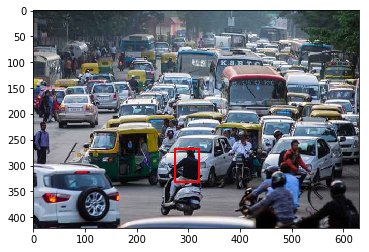

person: [250.        262.        323.        370.          0.6585952]


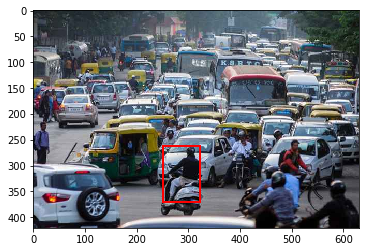

person: [471.        255.        535.        373.          0.9241431]


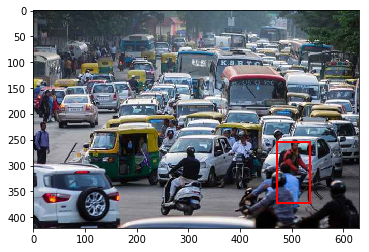

person: [4.2100000e+02 3.0300000e+02 4.7300000e+02 3.6600000e+02 3.4916854e-01]


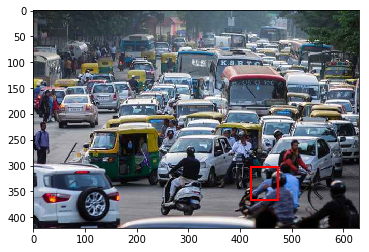

person: [416.        316.        512.        419.          0.9945706]


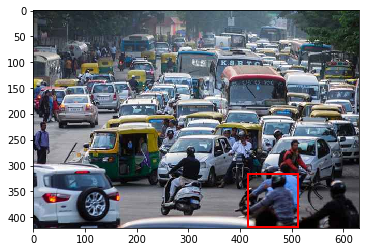

person: [498.        335.        628.        419.          0.9360165]


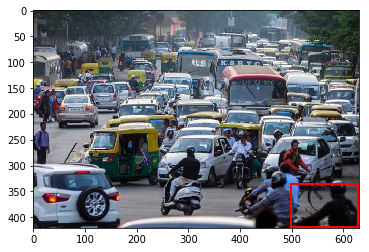

bicycle: [5.21000e+02 3.14000e+02 5.73000e+02 3.83000e+02 3.25957e-01]


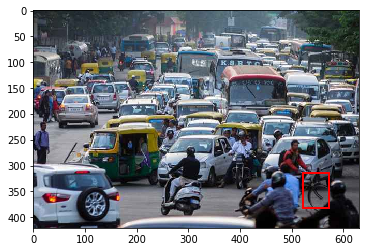

bicycle: [4.1000000e+02 3.8000000e+02 5.3000000e+02 4.2000000e+02 1.4693527e-01]


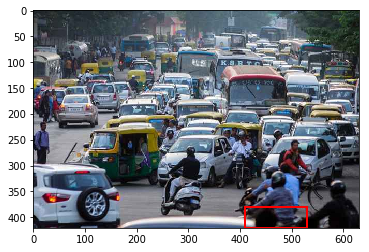

bicycle: [4.3500000e+02 2.4900000e+02 5.8300000e+02 3.4900000e+02 1.5890436e-01]


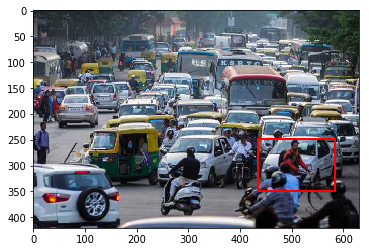

bicycle: [4.2600000e+02 3.0300000e+02 5.7000000e+02 3.7700000e+02 1.4819717e-01]


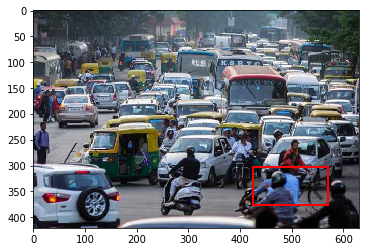

car: [2.6900000e+02 5.1000000e+01 2.9700000e+02 7.2000000e+01 2.0925802e-01]


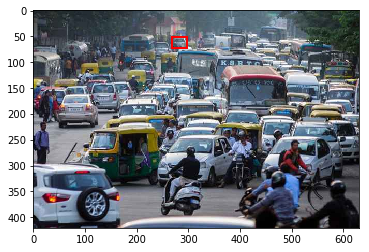

car: [285.          60.         314.          79.           0.39487627]


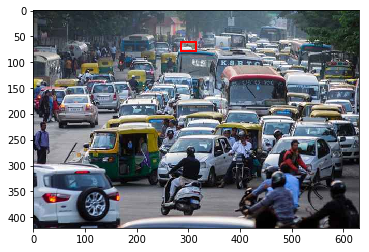

car: [4.3000000e+02 7.3000000e+01 4.7300000e+02 9.1000000e+01 2.7817467e-01]


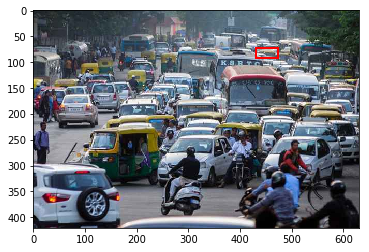

car: [4.3900000e+02 8.9000000e+01 4.6800000e+02 1.0900000e+02 1.5101556e-01]


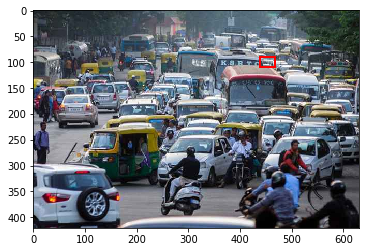

car: [5.6700000e+02 9.4000000e+01 6.0900000e+02 1.0900000e+02 1.0525642e-01]


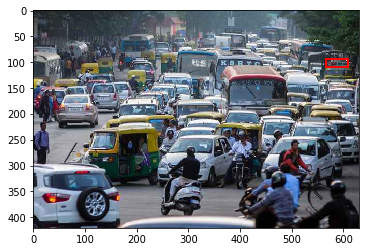

car: [1.2400000e+02 8.9000000e+01 1.5400000e+02 1.2400000e+02 1.2516433e-01]


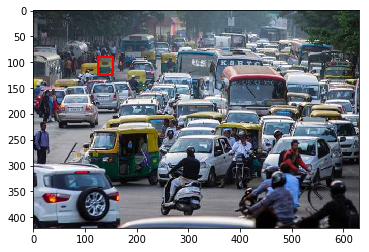

car: [ 85.        102.        127.        128.          0.2654951]


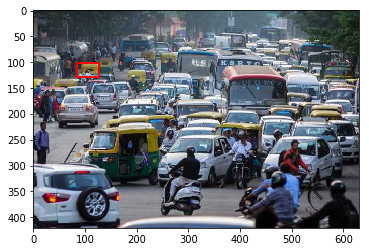

car: [4.760000e+02 1.060000e+02 5.280000e+02 1.260000e+02 1.585545e-01]


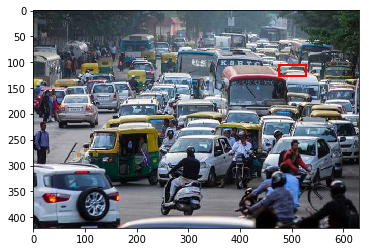

car: [5.5800000e+02 1.0200000e+02 6.1400000e+02 1.3200000e+02 1.0596578e-01]


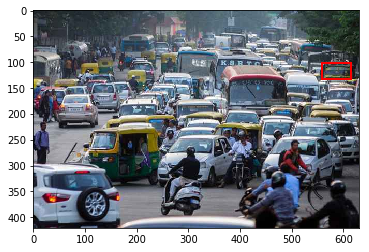

car: [ 99.         124.         156.         143.           0.39249206]


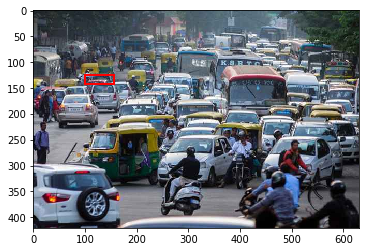

car: [6.0100000e+02 1.2800000e+02 6.2800000e+02 1.4300000e+02 1.6948576e-01]


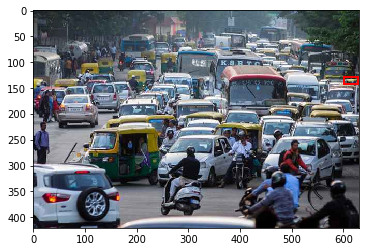

car: [ 37.        131.         89.        150.          0.5605053]


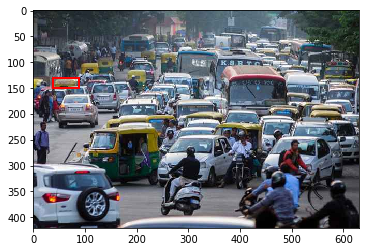

car: [ 96.         132.         141.         151.           0.20544882]


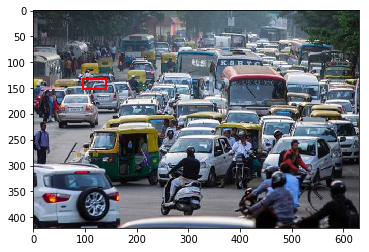

car: [5.900000e+01 1.470000e+02 1.050000e+02 1.660000e+02 1.652742e-01]


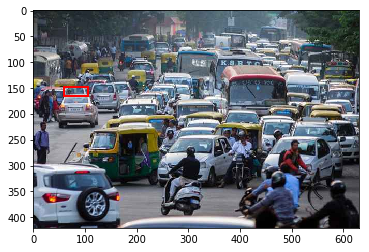

car: [159.         140.         189.         175.           0.27400872]


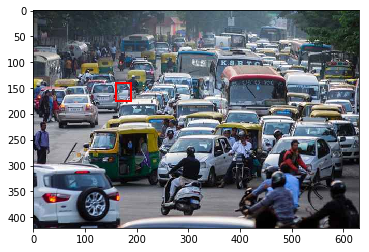

car: [5.6300000e+02 1.7000000e+02 6.1800000e+02 1.9800000e+02 4.6030027e-01]


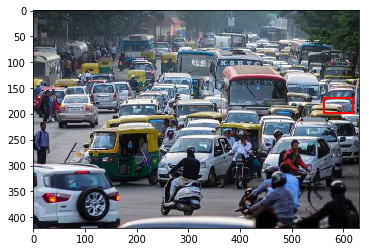

car: [4.5800000e+02 1.8500000e+02 5.1500000e+02 2.0900000e+02 3.7219468e-01]


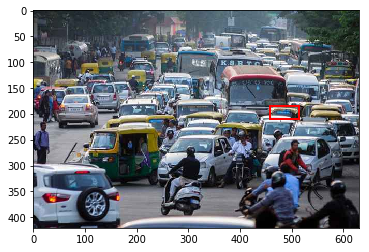

car: [5.9700000e+02 1.9800000e+02 6.2900000e+02 2.3000000e+02 1.5025935e-01]


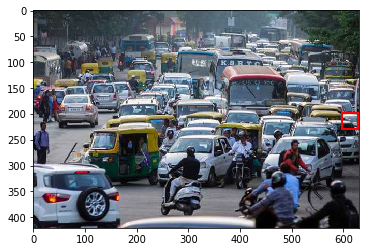

car: [190.          94.         236.         148.           0.54655766]


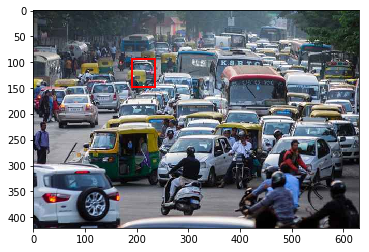

car: [180.         113.         223.         162.           0.60355395]


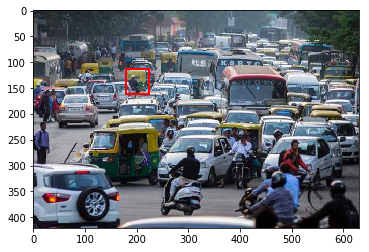

car: [238.        120.        312.        165.          0.7576869]


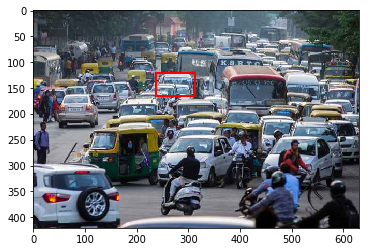

car: [222.         136.         288.         177.           0.67420185]


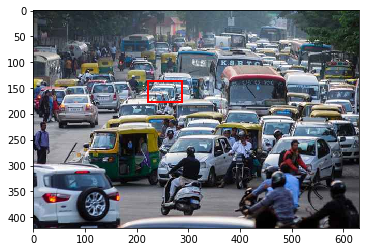

car: [3.5000000e+01 1.4600000e+02 8.0000000e+01 1.9700000e+02 1.4137645e-01]


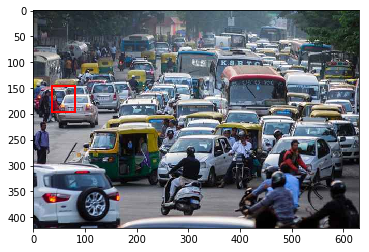

car: [109.        142.        167.        201.          0.9794004]


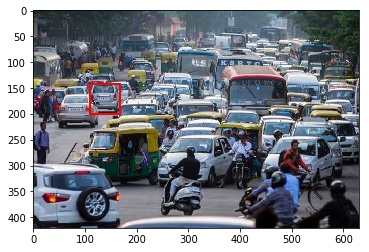

car: [197.         152.         265.         196.           0.81577677]


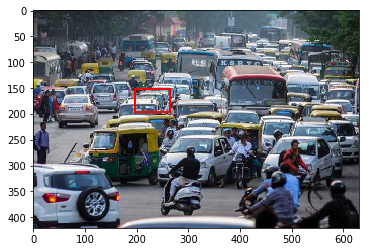

car: [5.5900000e+02 1.4400000e+02 6.2500000e+02 1.9500000e+02 2.4301013e-01]


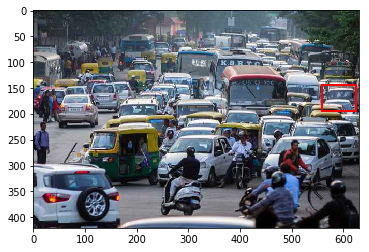

car: [165.         165.         248.         208.           0.88770294]


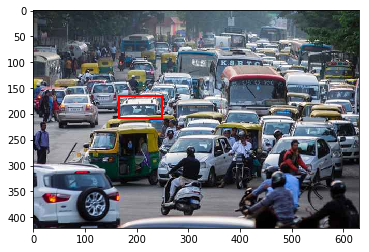

car: [ 44.        164.        127.        228.          0.9951478]


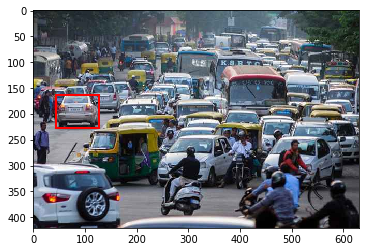

car: [264.        169.        357.        226.          0.4985463]


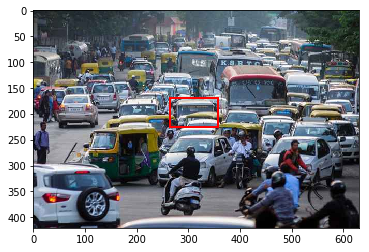

car: [366.        190.        438.        223.          0.8504403]


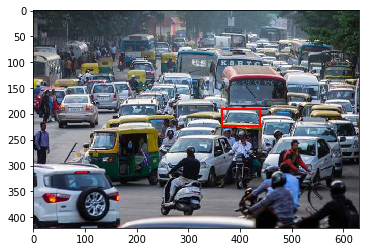

car: [5.2700000e+02 1.8200000e+02 6.0500000e+02 2.1900000e+02 4.5474762e-01]


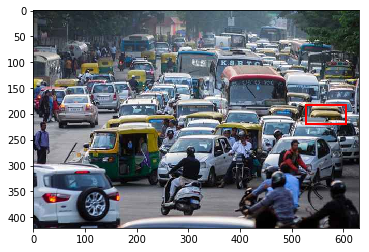

car: [284.         197.         368.         236.           0.40411392]


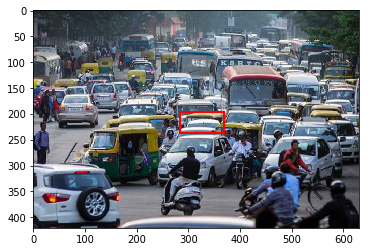

car: [2.2600000e+02 2.0600000e+02 2.7600000e+02 2.6200000e+02 1.3453457e-01]


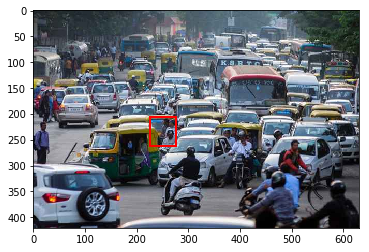

car: [4.370000e+02 2.070000e+02 5.020000e+02 2.700000e+02 4.987072e-01]


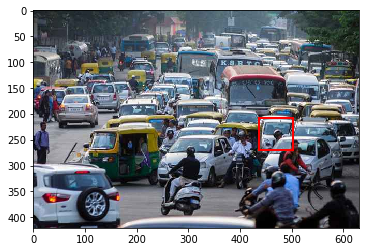

car: [572.        214.        629.        290.          0.9560457]


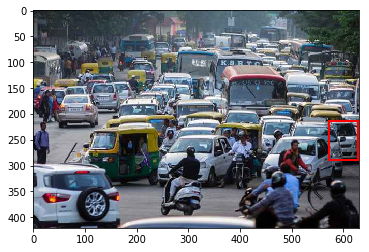

car: [141.         396.         424.         419.           0.47538143]


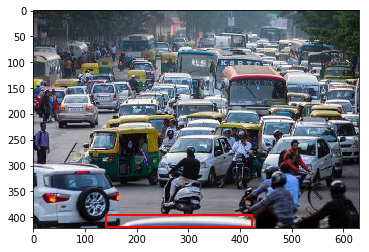

car: [4.2000000e+01 5.7000000e+01 5.9000000e+02 2.9700000e+02 3.3574575e-01]


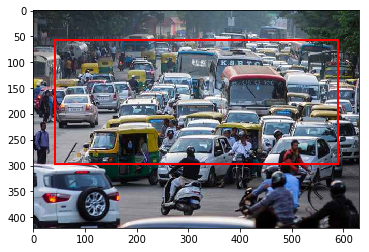

car: [ 90.        219.        250.        335.          0.8969028]


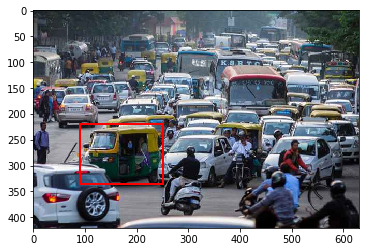

car: [235.        233.        395.        336.          0.9983606]


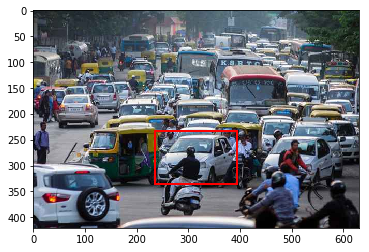

car: [438.        237.        591.        322.          0.9923331]


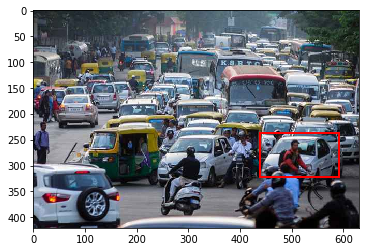

car: [  0.         281.         172.         420.           0.99225986]


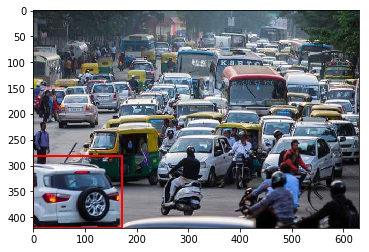

bike: [4.0000000e+00 1.5500000e+02 3.5000000e+01 2.1500000e+02 1.1829519e-01]


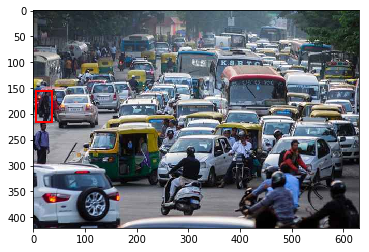

bike: [0.0000000e+00 1.6600000e+02 1.0000000e+01 2.1200000e+02 1.6904056e-01]


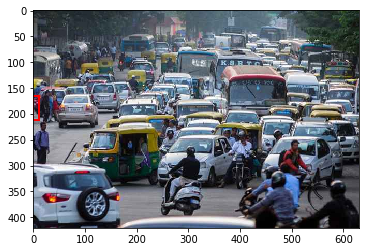

bike: [381.         282.         426.         345.           0.94976634]


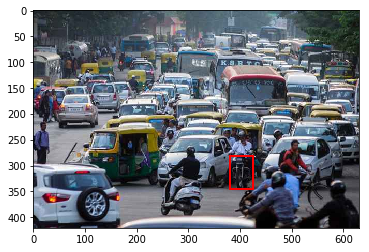

bike: [241.         333.         332.         396.           0.84534675]


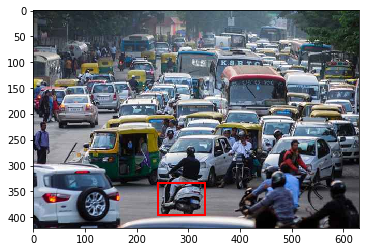

bike: [3.90000e+02 3.37000e+02 4.43000e+02 3.93000e+02 2.56566e-01]


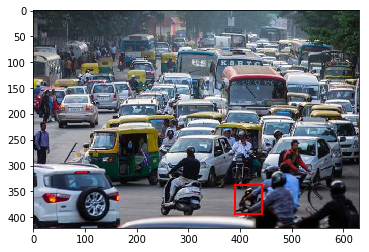

bike: [5.170000e+02 3.760000e+02 6.230000e+02 4.180000e+02 1.241271e-01]


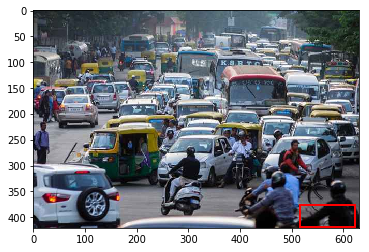

bus: [228.         59.        265.         82.          0.6117183]


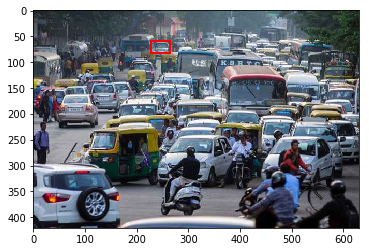

bus: [436.         31.        491.         60.          0.6199144]


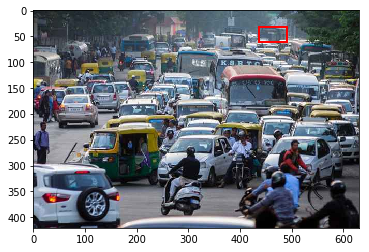

bus: [3.2100000e+02 4.6000000e+01 3.5300000e+02 7.3000000e+01 2.5129545e-01]


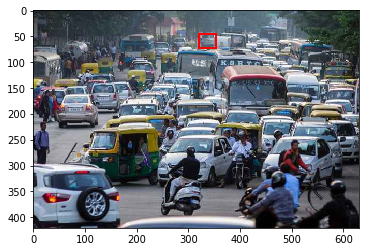

bus: [352.         43.        413.         76.          0.8707462]


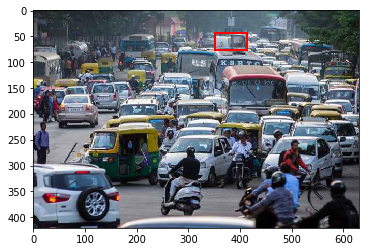

bus: [5.1800000e+02 6.1000000e+01 5.7700000e+02 8.0000000e+01 2.0840497e-01]


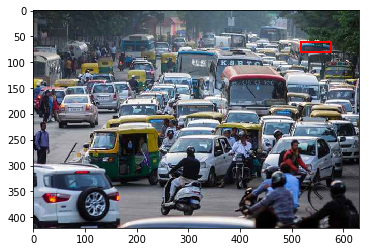

bus: [2.080000e+02 7.600000e+01 2.370000e+02 9.600000e+01 2.343139e-01]


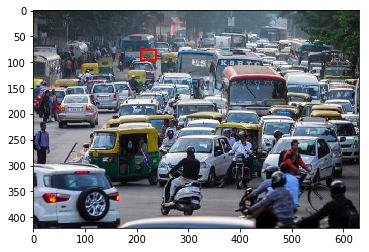

bus: [246.         84.        278.        120.          0.7207223]


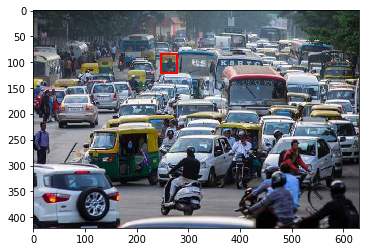

bus: [172.          45.         227.          95.           0.86777467]


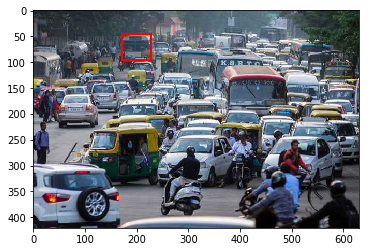

bus: [4.7300000e+02 5.4000000e+01 5.2400000e+02 1.0000000e+02 1.1649402e-01]


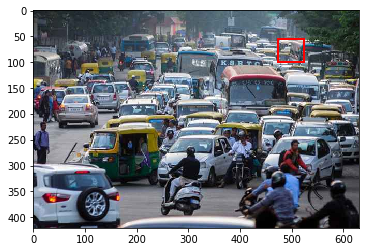

bus: [  0.          75.          60.         142.           0.95501214]


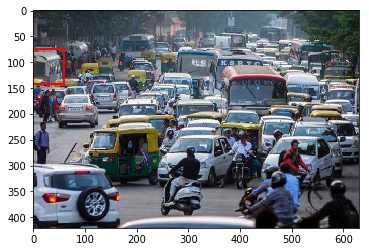

bus: [3.5000000e+02 8.0000000e+01 4.4700000e+02 1.2800000e+02 1.6681392e-01]


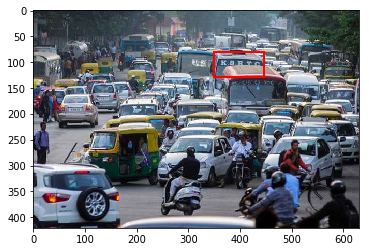

bus: [5.2300000e+02 8.0000000e+01 5.7600000e+02 1.2300000e+02 2.9559326e-01]


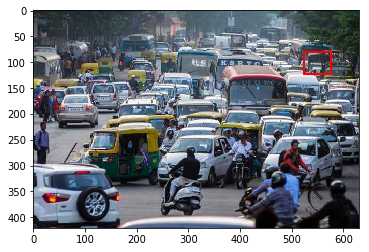

bus: [198.          93.         241.         145.           0.35593382]


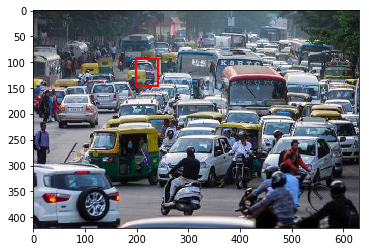

bus: [278.        75.       363.       169.         0.980555]


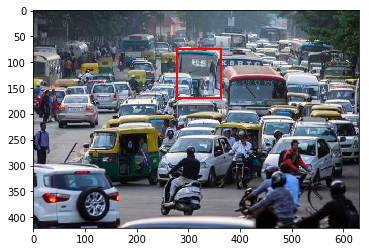

bus: [5.5400000e+02 9.7000000e+01 6.1800000e+02 1.3700000e+02 4.3946373e-01]


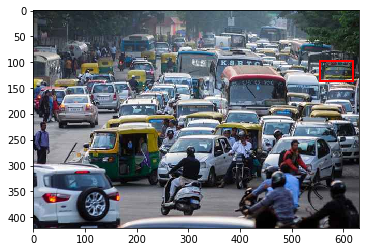

bus: [485.         119.         560.         181.           0.92619187]


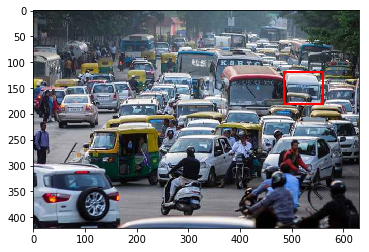

bus: [350.          97.         492.         194.           0.95007277]


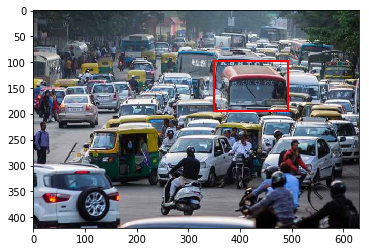

In [0]:
for l in list_of_classes:
  number=int((boxes[l].size)/5)
  for i in range(number):
    print("%s: %s" % (classes[str(l)], boxes[l][i]))  # iterating through each class to check which are present in image

  #import numpy as np
    import matplotlib.pyplot as plt
    box = boxes[l][i]
    plt.imshow(img[0].astype(np.uint8))
    plt.gca().add_patch(plt.Rectangle(
        (box[0], box[1]), box[2] - box[0], box[3] - box[1],
        fill=False, edgecolor='r', linewidth=2))
    plt.show()
      
    

In [0]:
boxes[0].size

45

In [0]:
for l in list_of_classes:   #to check which object is present
  if (boxes[l].size>0):
    print(classes[str(l)]+"  " +"detected")

person  detected
bicycle  detected
car  detected
bike  detected
bus  detected
truck  detected


In [0]:
!rm -r person

In [0]:
!mkdir person

In [0]:
classes={'0':'person','1':'bicycle','2':'car','3':'bike','5':'bus','7':'truck'}
list_of_classes=[0,1,2,3,5,7]

In [0]:
  # Importing all necessary libraries 
  import cv2 
  import os 

  # Read the video from specified path 
  cam = cv2.VideoCapture("/content/India_8698.mp4") #braking the video to images of frames

  try: 

    # creating a folder named data 
    if not os.path.exists('data'): 
      os.makedirs('data') 

  # if not created then raise error 
  except OSError: 
    print ('Error: Creating directory of data') 

  # frame 
  currentframe = 0
  sec=0
  framerate=0.5

  while(True): 

    # reading from frame 
    ret,frame = cam.read() 
    cam.set(cv2.CAP_PROP_POS_MSEC,sec*1000)

    if ret: 
      # if video is still left continue creating images 
      name = './data/frame' + str(currentframe) + '.jpg'
      print ('Creating...' + name) 

      # writing the extracted images 
      cv2.imwrite(name, frame)
      sec=sec+framerate

      # increasing counter so that it will 
      # show how many frames are created 
      currentframe += 1
    else: 
      break

  # Release all space and windows once done 
  cam.release() 
  cv2.destroyAllWindows() 


In [0]:
currentframe

79

In [0]:
classes={'0':'person','1':'bicycle','2':'car','3':'bike','5':'bus','7':'truck'}
list_of_classes=[0,1,2,3,5,7]

In [0]:
import tensorflow as tf
import tensornets as nets
import cv2
import numpy as np
import time
import shutil
import os

In [0]:
import glob

In [0]:
images=glob.glob("data/*.jpg") #to take all the images 

In [0]:
images[1]

'data/frame349.jpg'

In [0]:
count=0
inputs = tf.placeholder(tf.float32, [None, 416, 416, 3])
model = nets.YOLOv3COCO(inputs, nets.Darknet19)
for image in images[76:]:
  img = nets.utils.load_img(image)
  

  with tf.Session() as sess:
      sess.run(model.pretrained())
      preds = sess.run(model.preds, {inputs: model.preprocess(img)})
      boxes = model.get_boxes(preds, img.shape[1:3])
  if (boxes[0].size>0):
    dest='gdrive/My Drive/Assignment/person'  #checking which object is present in a frame and sending that to a particular folder 
    shutil.copy2(image,dest)
    
  

W0711 20:37:39.063204 139924806461312 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/tensornets/utils.py:238: The name tf.variable_scope is deprecated. Please use tf.compat.v1.variable_scope instead.

W0711 20:37:39.327636 139924806461312 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/tensornets/utils.py:277: The name tf.get_variable_scope is deprecated. Please use tf.compat.v1.get_variable_scope instead.

W0711 20:37:42.099514 139924806461312 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/tensornets/utils.py:246: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0711 20:37:42.100538 139924806461312 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/tensornets/utils.py:125: The name tf.get_collection is deprecated. Please use tf.compat.v1.get_collection instead.

W0711 20:37:43.433669 139924806461312 deprecation_wrapper.py:119] From /usr/local/

In [ ]:
net = model_zoo.get_model('ssd_512_resnet50_v1_voc', pretrained=True) #downloading pretrained ssd models

In [ ]:
for image in images:
    x, img = data.transforms.presets.ssd.load_test(image, short=512)
    class_IDs, scores, bounding_boxes = net(x)
    for i in range(100):
        class_IDs[0][i]==14:    #iterating through 6,14,5,1,13
        dest='gdrive/My Drive/Assignment/person'  #checking which object is present in a frame and sending that to a particular folder 
        shutil.copy2(image,dest)   

In [0]:

import cv2
import numpy as np   #creating video from images 
import glob
 
img_array = []
size=0
for filename in glob.glob(r'C:\Users\ARKA4\Downloads\Assignment\object_extraction\images\car\*.jpg'):
    img = cv2.imread(filename)
    height, width, layers = img.shape
    size = (width,height)
    print(size)
    img_array.append(img)
 
out = cv2.VideoWriter('car.avi',cv2.VideoWriter_fourcc(*'DIVX'),2, size)
for i in range(len(img_array)):
    out.write(img_array[i])
out.release()